# Grassmannian Interpolation

**Input to create interpolator**:

- 2D shapes (cross sections)
- normalized locations of these shapes along the 3rd direction

**Requirements**:

- 2D shapes parallel to each other 
- Equal number of landmarks (points defining a shape in 2D)
- Locations along the 3rd direction are mormalized from 0 to 1

## Interpolation for a blade defined as .yaml file

Usually, a wind turbine blade definition is provided by a .yaml file which contains cross sectional airfoils (normalized by chord size), 
their location along the blade span, and profiles of pitch axis (axis of twist), pitch angle (twist), scaling, and shift.

Our routine for blade interpolation consists of the following steps:

  1. Read the blade definition from the .yaml file and reparametrize given cross-section airfoils so they have an equal number of landmarks.
  2. Interpolate shapes between given cross-sections with the unit chord.
  3. Apply affine transformation to the interpolated shapes to scale, rotate, shift and bend (out-of-plane rotation) the blade according to the profiles provided in .yaml file.

This example also can be found as a script in `G2Aero/examples/blade_interpolation.py`

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from g2aero.yaml_info import YamlInfo
from g2aero.Grassmann_interpolation import GrassmannInterpolator
from g2aero.transform import TransformBlade, global_blade_coordinates

### 1. Reading blade definition from .yaml file
We first create a class object ``Blade`` with information from .yaml file and 
save ``Blade.xy_landmarks`` (2D cross sectional airfoils reparametrized to have the same number of landmarks)
and ``Blade.eta_nominal`` (locations from 0 to 1 of these cross sections along the normalized blade span as $\eta$) to use as input for the interpolator.
Note that the number of landmarks is defined by the user and set to ``n_landmarks=401`` in this example.

Text(0.5, 1.0, 'Given nominal shapes')

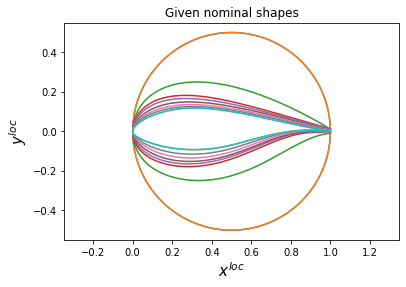

In [2]:
# shapes_filename = os.path.join(os.getcwd(), "../../data/blades_yamls/nrel5mw_ofpolars.yaml")
shapes_filename = os.path.join(os.getcwd(), "../../data/blades_yamls/IEA-15-240-RWT.yaml")
Blade = YamlInfo(shapes_filename, n_landmarks=401) 
xy_nominal = Blade.xy_landmarks 
eta_nominal = Blade.eta_nominal 

fig, ax = plt.subplots(1, 1)
for i, xy in enumerate(xy_nominal):
    ax.plot(xy[:, 0], xy[:, 1])
ax.axis('equal')
ax.set_xlabel(r'$x^{loc}$', fontsize=15)
ax.set_ylabel(r'$y^{loc}$', fontsize=15)
ax.set_title('Given nominal shapes')

### 2. Interpolation

Then we create the interpolator `GrInterp` with given 2D cross sections and their spanwise location as input parameters.

In [3]:
GrInterp = GrassmannInterpolator(eta_nominal, xy_nominal)

Now we need to define an array of spanwise locations where we want to get new interpolated cross-sections. We can provide any desired locations, e.g. 500 locations uniform along the blade span

In [4]:
eta_span = np.linspace(0, 1, 200)

or generate locations using the interpolator method. It distributes locations according to the Grassmann distance between given shapes. 
Note that this method also has arguments `n_hub`, `n_tip`, `n_end`, which can help specify refinements near the hub and near the tip (see Technical Reference for method details)

In [5]:
eta_span = GrInterp.sample_eta(n_samples=200)

Next, we pass the array of desired locations to the interpolator to get interpolated shapes. `phys_crosssections` contains 2D interpolated shapes parallel to each other and with the unit chord.

Text(0.5, 1.0, 'Interpolated shapes')

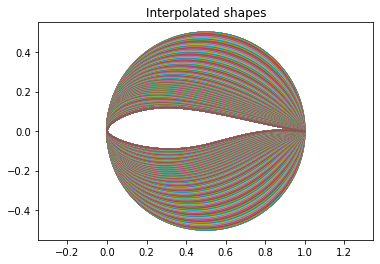

In [6]:
phys_crosssections, gr_crosssections = GrInterp(eta_span, grassmann=True)

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
for i, xy in enumerate(phys_crosssections):
    ax.plot(xy[:, 0], xy[:, 1])
ax.axis('equal')
ax.set_title("Interpolated shapes")

### 3. Apply affine transformation

Finally, we apply affine transformation to the interpolated shapes to scale, rotate, shift and bend (out-of-plane rotation) the blade according to the profiles provided in .yaml file. 

In [7]:
M_yaml = Blade.M_yaml_interpolator
b_yaml = Blade.b_yaml_interpolator
b_pitch = Blade.pitch_axis
M = GrInterp.interpolator_M
b = GrInterp.interpolator_b

Transform = TransformBlade(M_yaml, b_yaml, b_pitch, M, b)
xyz_local = Transform.grassmann_to_phys(gr_crosssections, eta_span)
xyz_global = global_blade_coordinates(xyz_local)

Now we can visualize interpolated blade. Black cross-sections are cross -sections provided by .yaml file

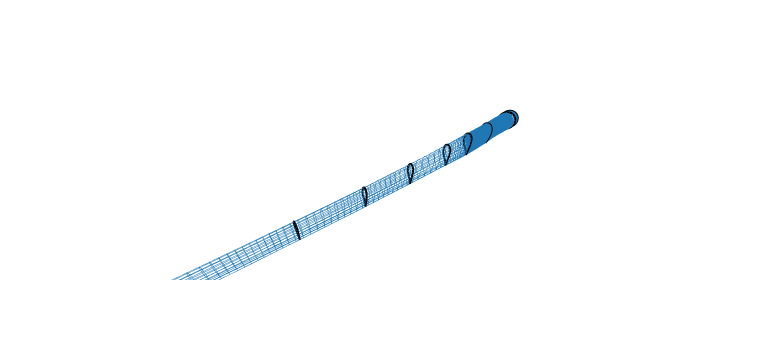

In [8]:
import sys
sys.path.insert(0, '../')
from plot_helpfunctions import plot_3d_blade

nominal_shapes = global_blade_coordinates(Transform.grassmann_to_phys(GrInterp.xy_grassmann, eta_nominal))
plot_3d_blade(xyz_global, nominal_shapes)